In [1]:
!pip install -q segmentation-models-pytorch tqdm albumentations ultralytics scikit-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 44.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 85.4 MB/s eta 0:00:00:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 67.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 40.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.8 MB/s eta 0:00:0000:0100:01m
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 11.9 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 1.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
import numpy as np
import pandas as pd
import os
import seaborn as sns
import matplotlib.pyplot as plt
import cv2
import torch
import torch.nn as nn
import albumentations as A
from albumentations.pytorch import ToTensorV2
import segmentation_models_pytorch as smp
from ultralytics import YOLO
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_absolute_percentage_error
from math import sqrt
import warnings
warnings.filterwarnings('ignore')

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
folder_path = '/kaggle/input/cell-counting-roboflow-segmentation-masks/aug_inference_only/images' 
file_list = os.listdir(folder_path)

sorted_list = sorted(file_list, key=lambda x: int(x.split('_')[0]))

print("List of original files:")
print(file_list)
print("\nList of files sorted by number:")
print(sorted_list)

List of original files:
['29_GT300_aug3.jpg', '8_GT44_aug3.jpg', '20_GT874_aug3.jpg', '35_GT300_aug3.jpg', '4_GT44_aug3.jpg', '21_GT913_aug3.jpg', '17_GT236_aug3.jpg', '9_GT52_aug2.jpg', '30_GT300_aug3.jpg', '33_GT43_aug3.jpg', '32_GT99_aug2.jpg', '28_GT261_aug2.jpg', '2_GT60_aug1.jpg', '13_GT36_aug1.jpg', '13_GT36_aug2.jpg', '16_GT60_aug2.jpg', '28_GT261_aug1.jpg', '13_GT36_aug3.jpg', '27_GT319_aug2.jpg', '26_GT386_aug1.jpg', '17_GT236_aug1.jpg', '21_GT913_aug2.jpg', '12_GT58_aug1.jpg', '10_GT46_aug2.jpg', '35_GT300_aug1.jpg', '24_GT422_aug1.jpg', '5_GT54_aug3.jpg', '3_GT60_aug1.jpg', '31_GT300_aug3.jpg', '23_GT838_aug2.jpg', '30_GT300_aug1.jpg', '29_GT300_aug1.jpg', '1_GT89_aug3.jpg', '34_GT298_aug2.jpg', '9_GT52_aug3.jpg', '16_GT60_aug3.jpg', '20_GT874_aug2.jpg', '3_GT60_aug2.jpg', '27_GT319_aug3.jpg', '12_GT58_aug3.jpg', '18_GT258_aug3.jpg', '25_GT401_aug1.jpg', '19_GT365_aug2.jpg', '6_GT68_aug1.jpg', '32_GT99_aug1.jpg', '21_GT913_aug1.jpg', '19_GT365_aug3.jpg', '15_GT46_aug3.jpg',

In [4]:
def estimate_average_cell_diameter(image_path):
    """
    This function estimates the average diameter of the cells in the image. 
    It is a heuristic that works by looking for white areas on a black background.
    """
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return None

    # Apply Otsu threshold to automatically separate background and object
    _, thresh = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Find the connecting components (cells)
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(thresh, connectivity=8)
    
    areas = []
    # Ignore label 0 (which is background)
    for i in range(1, num_labels):
        if 10 < stats[i, cv2.CC_STAT_AREA] < 50000:
            areas.append(stats[i, cv2.CC_STAT_AREA]) # Filter out too small noise dots or too large objects
    if not areas:
        return None

    # Calculate diameter from average area (Area = pi * r^2)
    avg_area = np.mean(areas)
    avg_radius = np.sqrt(avg_area / np.pi)
    avg_diameter = avg_radius * 2
    
    return avg_diameter

# ======================================================
# Image processing and Visualization Function
# ======================================================

In [5]:
def preprocess_image(image, use_sobel_sharpening=False):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced_contrast = clahe.apply(gray)
    if not use_sobel_sharpening:
        return cv2.cvtColor(enhanced_contrast, cv2.COLOR_GRAY2RGB)
    else:
        sobelx = cv2.Sobel(enhanced_contrast, cv2.CV_64F, 1, 0, ksize=3)
        sobely = cv2.Sobel(enhanced_contrast, cv2.CV_64F, 0, 1, ksize=3)
        sobel_magnitude = cv2.magnitude(sobelx, sobely)
        sobel_magnitude = cv2.normalize(sobel_magnitude, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
        combined_image = cv2.addWeighted(enhanced_contrast, 0.7, sobel_magnitude, 0.3, 0)
        return cv2.cvtColor(combined_image, cv2.COLOR_GRAY2RGB)

def post_process_mask(mask, min_area=25, open_kernel_size=3):
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (open_kernel_size, open_kernel_size))
    opened_mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(opened_mask, connectivity=8)
    cleaned_mask = np.zeros_like(opened_mask)
    for i in range(1, num_labels):
        if stats[i, cv2.CC_STAT_AREA] >= min_area:
            cleaned_mask[labels == i] = 255
    return cleaned_mask

def count_objects(binary_mask):
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return len(contours)

def visualize_unet_prediction(original_bgr_image, cleaned_mask, num_objects, border_size=2, color=(0, 255, 0)):
    overlay = original_bgr_image.copy()
    contours, _ = cv2.findContours(cleaned_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cv2.drawContours(overlay, contours, -1, color, border_size)
    original_rgb = cv2.cvtColor(original_bgr_image, cv2.COLOR_BGR2RGB)
    overlay_rgb = cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1); plt.imshow(original_rgb); plt.title('Original Image'); plt.axis('off')
    plt.subplot(1, 3, 2); plt.imshow(cleaned_mask, cmap='gray'); 
    plt.title('Cleaned Mask'); 
    plt.axis('off')
    plt.subplot(1, 3, 3); plt.imshow(overlay_rgb); 
    plt.title(f'U-Net Detected: {num_objects}'); plt.axis('off')
    plt.tight_layout();
    plt.show()

def visualize_yolo_prediction(original_bgr_image, yolo_results, num_objects, color=(0, 255, 0), thickness=2):
    overlay = original_bgr_image.copy()
    for box in yolo_results[0].boxes.xyxy.cpu().numpy():
        x1, y1, x2, y2 = box[:4]
        center_x = int((x1 + x2) / 2)
        center_y = int((y1 + y2) / 2)
        radius = int(min(x2 - x1, y2 - y1) / 2)
        cv2.circle(overlay, (center_x, center_y), radius, color, thickness)
    original_rgb = cv2.cvtColor(original_bgr_image, cv2.COLOR_BGR2RGB)
    overlay_rgb = cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1); plt.imshow(original_rgb); plt.title('Original Image'); plt.axis('off')
    plt.subplot(1, 2, 2); plt.imshow(overlay_rgb); plt.title(f'YOLO Detections: {num_objects}'); plt.axis('off')
    plt.tight_layout(); plt.show()

# ======================================================
# Pipline Function
# ======================================================

In [6]:
def predict_unet_mask(model, device, image_tensor, unet_threshold):
    model.eval()
    with torch.no_grad():
        image_tensor = image_tensor.to(device)
        outputs = model(image_tensor)
        probs = torch.softmax(outputs, dim=1)
        binary = probs[:, 1, :, :] > unet_threshold
        return binary.cpu().numpy().astype(np.uint8) * 255

def unet_counting_pipeline(model, device, image_path, transform, unet_threshold, min_area=25):
    image = cv2.imread(image_path)
    if image is None: return 0, None, None
    TARGET_CELL_DIAMETER = 60.0 # Set target diameter
    
    current_diameter = estimate_average_cell_diameter(image_path)
    
    if current_diameter is not None and current_diameter > 0:
        resize_factor = TARGET_CELL_DIAMETER / current_diameter
        new_height = int(image.shape[0] * resize_factor)
        new_width = int(image.shape[1] * resize_factor)
        
        # Overwrite the 'image' variable with the resized image
        image = cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_AREA)
    
    orig_h, orig_w = image.shape[:2]
    preprocessed_rgb = preprocess_image(image)
    transformed = transform(image=preprocessed_rgb)
    input_tensor = transformed["image"].unsqueeze(0)
    
    pred_mask_batch = predict_unet_mask(model, device, input_tensor, unet_threshold)
    pred_mask = pred_mask_batch[0]
    mask_resized = cv2.resize(pred_mask, (orig_w, orig_h), interpolation=cv2.INTER_NEAREST)
    cleaned_mask = post_process_mask(mask_resized, min_area=min_area)
    num_objects = count_objects(cleaned_mask)
    
    return num_objects, cleaned_mask, image

def count_cells_yolo(model, image_path, conf_threshold=0.45):
    img = cv2.imread(image_path)
    if img is None: return 0, None, None
    results = model(img, verbose=False, conf=conf_threshold, max_det=1000, augment = True)
    num_objects = len(results[0].boxes)
    return num_objects, img, results

# ======================================================
# LOAD MODEL AND TRANSFORM DEFINITION
# ======================================================

In [7]:
# --- Transform ---
test_transform = A.Compose([
    A.Resize(256, 256),
    A.Normalize(mean=(0.0, 0.0, 0.0), std=(1.0, 1.0, 1.0)),
    ToTensorV2()
])

# --- Load U-Net Model ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model_unet = smp.Unet(
    encoder_name="resnet152",
    encoder_weights="imagenet",
    classes=2,
    activation=None,
)
model_unet = nn.DataParallel(model_unet)
model_unet.load_state_dict(torch.load("/kaggle/input/cells-counting/pytorch/default/2/kaggle/working/cell_models/best_unet_model.pth", map_location=device))
model_unet.to(device)
model_unet.eval()
print(f"U-Net model loaded successfully on device: {device}")

# --- Load YOLO Model ---
model_path_yolo = '/kaggle/input/cells-counting/pytorch/default/2/kaggle/working/cell_models/best.pt'
model_yolo = YOLO(model_path_yolo)
print("YOLO model loaded successfully.")

config.json:   0%|          | 0.00/156 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/241M [00:00<?, ?B/s]

U-Net model loaded successfully on device: cpu
YOLO model loaded successfully.


# ======================================================
# REVIEW, REFINE, AND VISUALIZE LOOP
# ======================================================

Bắt đầu đánh giá trên 105 ảnh...
Tham số U-Net: min_area = 20, conf_threshold = 0.6
Tham số YOLO: conf_threshold = 0.45
Các ảnh sẽ được hiển thị kết quả: [57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68]
------------------------------------------------------------
Ảnh 1/105: GT=89, UNet=44, YOLO=89
Ảnh 2/105: GT=89, UNet=51, YOLO=93
Ảnh 3/105: GT=89, UNet=49, YOLO=94
Ảnh 4/105: GT=60, UNet=53, YOLO=62
Ảnh 5/105: GT=60, UNet=59, YOLO=55
Ảnh 6/105: GT=60, UNet=44, YOLO=57
Ảnh 7/105: GT=60, UNet=61, YOLO=72
Ảnh 8/105: GT=60, UNet=57, YOLO=63
Ảnh 9/105: GT=60, UNet=57, YOLO=61
Ảnh 10/105: GT=44, UNet=39, YOLO=42
Ảnh 11/105: GT=44, UNet=36, YOLO=50
Ảnh 12/105: GT=44, UNet=37, YOLO=42
Ảnh 13/105: GT=54, UNet=49, YOLO=57
Ảnh 14/105: GT=54, UNet=42, YOLO=56
Ảnh 15/105: GT=54, UNet=47, YOLO=55
Ảnh 16/105: GT=68, UNet=50, YOLO=64
Ảnh 17/105: GT=68, UNet=47, YOLO=74
Ảnh 18/105: GT=68, UNet=54, YOLO=66
Ảnh 19/105: GT=48, UNet=46, YOLO=55
Ảnh 20/105: GT=48, UNet=43, YOLO=63
Ảnh 21/105: GT=48, UNet=4

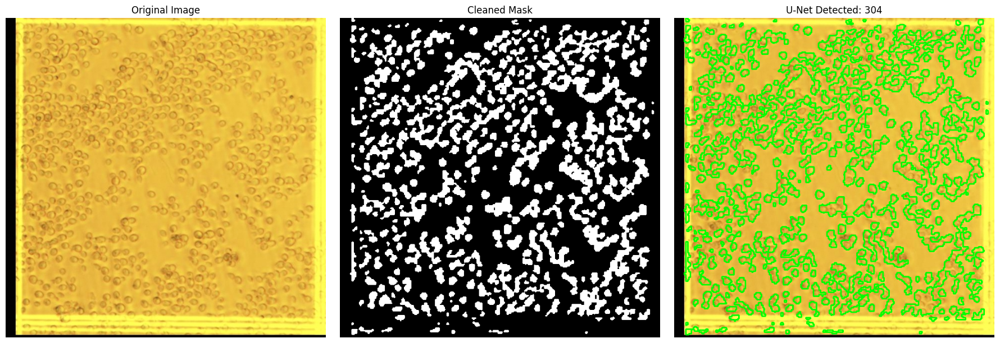

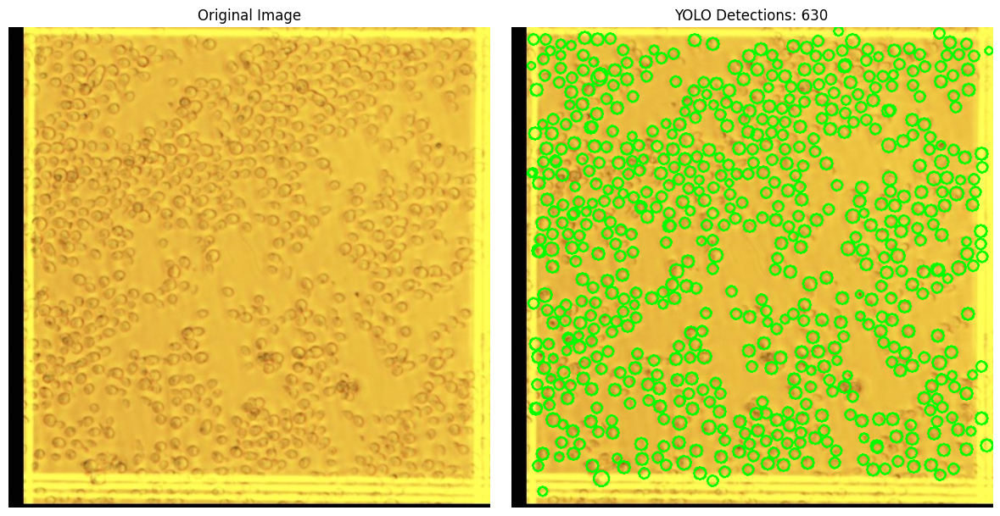

Ảnh 59/105: GT=874, UNet=315, YOLO=644
   ---> Showing visual results for images 59...


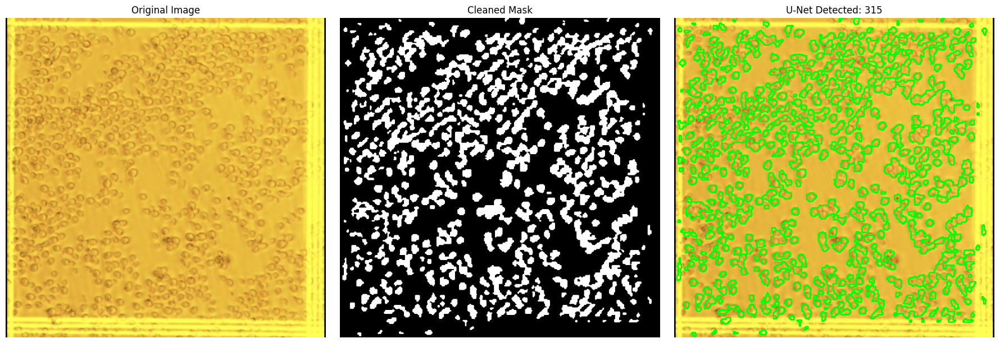

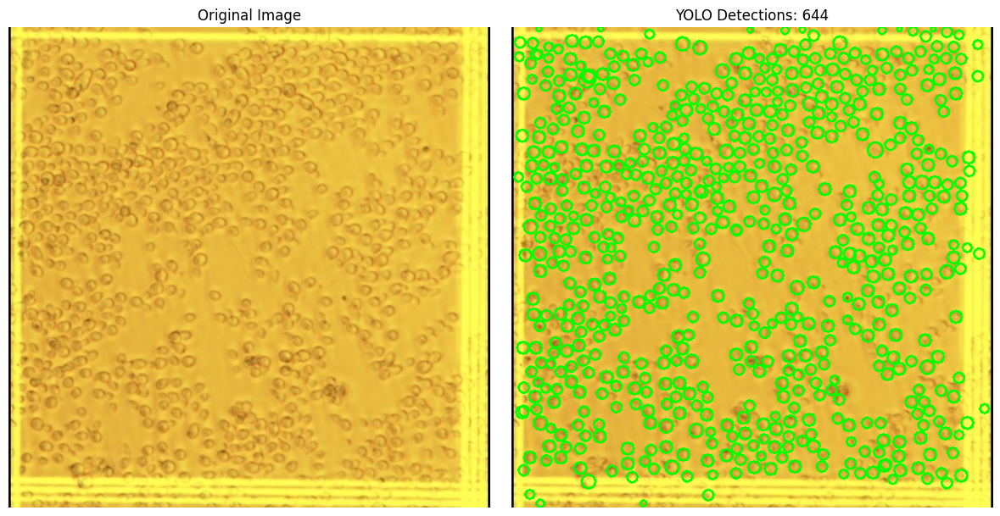

Ảnh 60/105: GT=874, UNet=310, YOLO=646
   ---> Showing visual results for images 60...


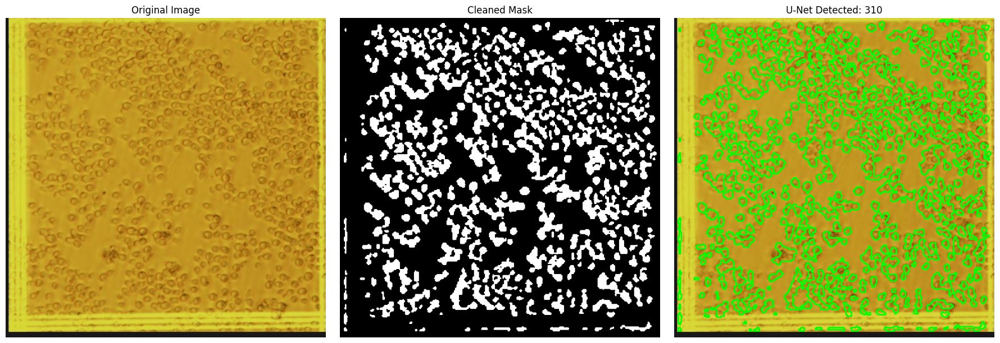

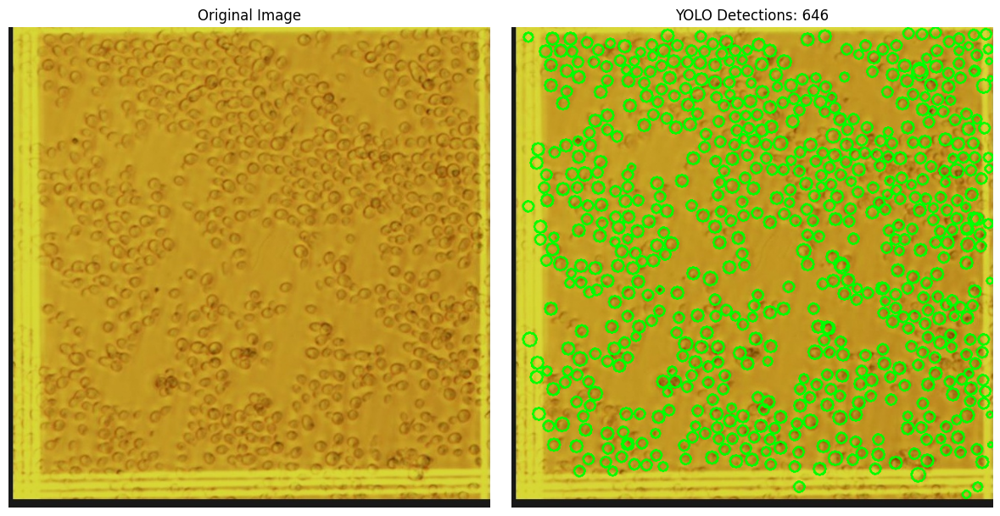

Ảnh 61/105: GT=913, UNet=382, YOLO=679
   ---> Showing visual results for images 61...


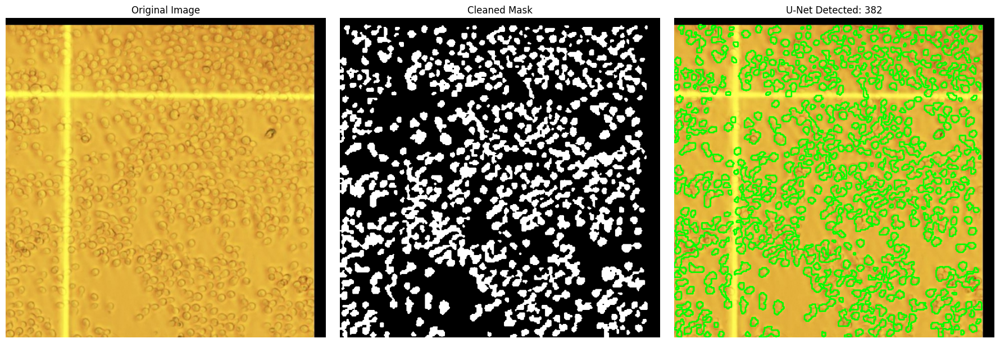

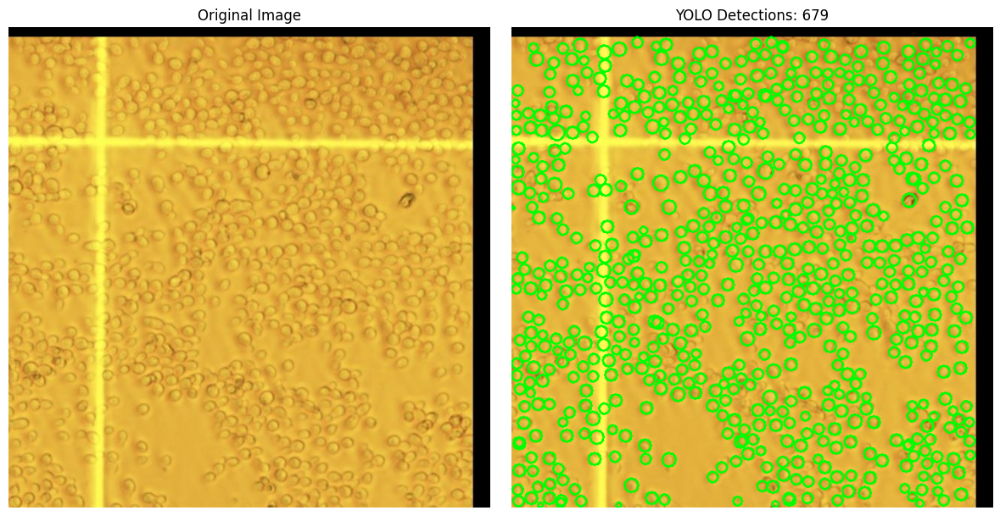

Ảnh 62/105: GT=913, UNet=425, YOLO=736
   ---> Showing visual results for images 62...


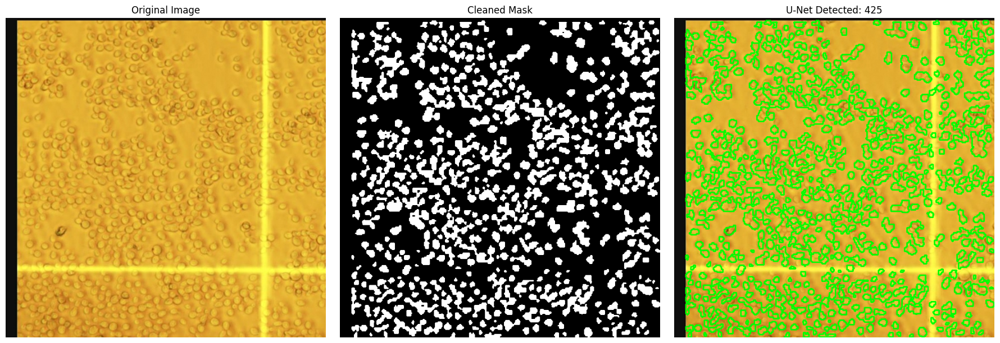

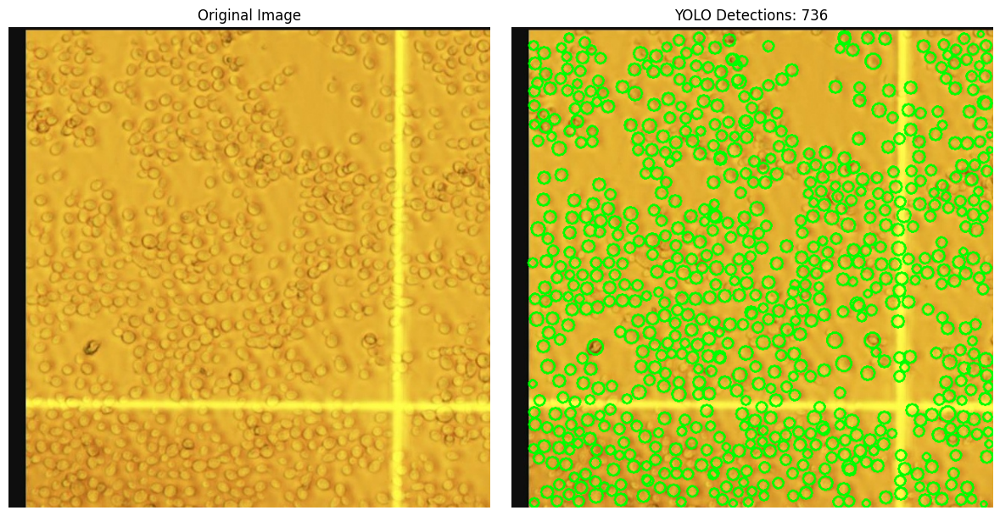

Ảnh 63/105: GT=913, UNet=338, YOLO=713
   ---> Showing visual results for images 63...


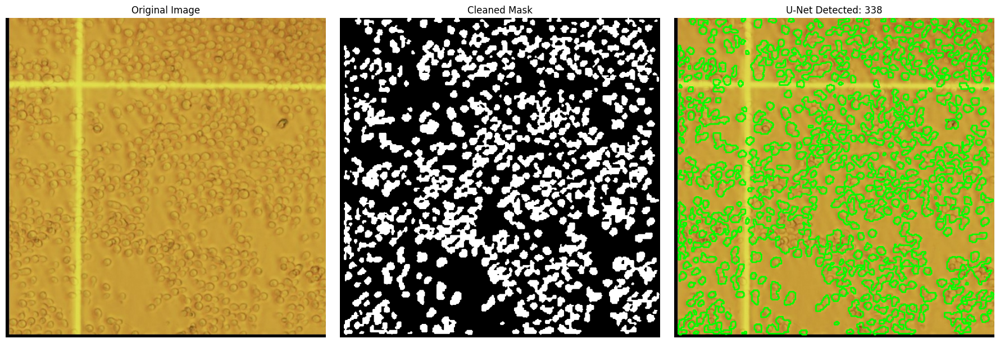

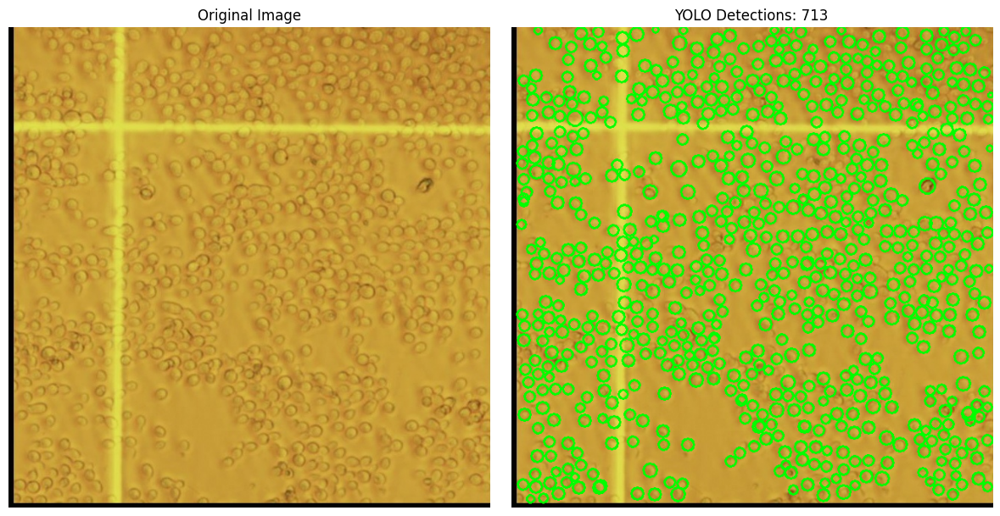

Ảnh 64/105: GT=740, UNet=412, YOLO=697
   ---> Showing visual results for images 64...


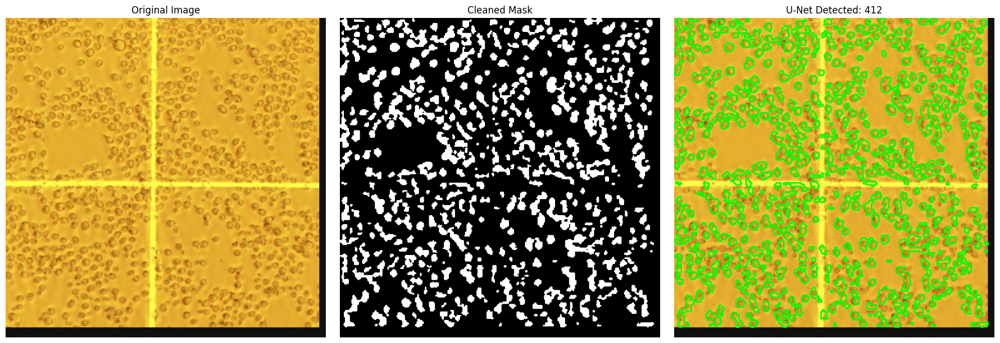

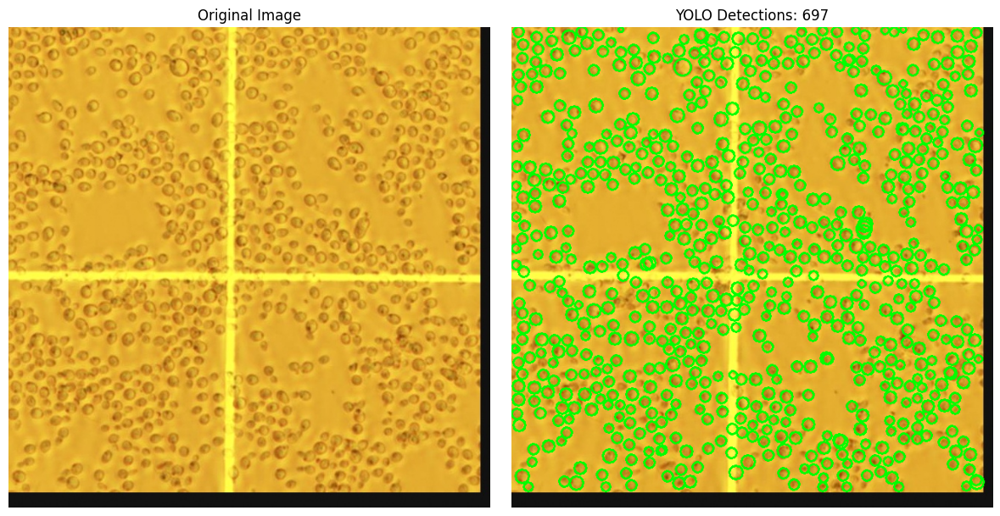

Ảnh 65/105: GT=740, UNet=547, YOLO=749
   ---> Showing visual results for images 65...


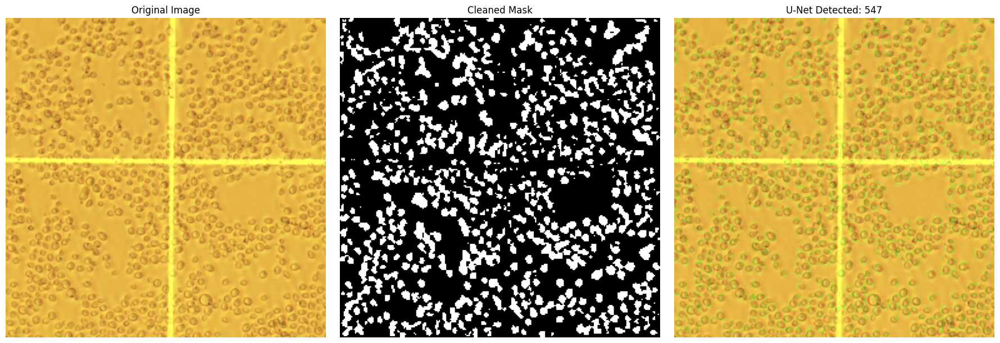

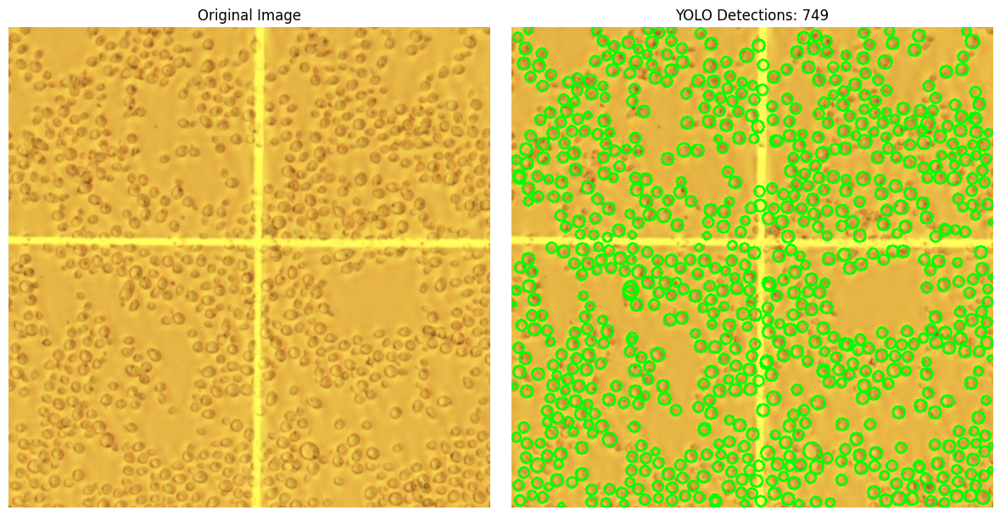

Ảnh 66/105: GT=740, UNet=518, YOLO=751
   ---> Showing visual results for images 66...


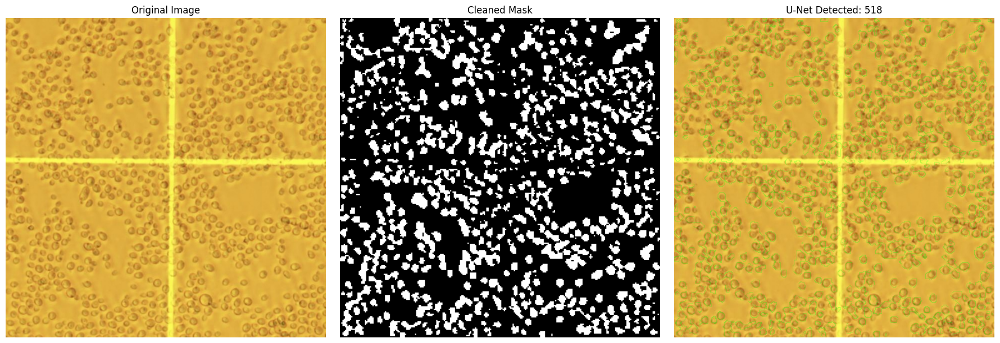

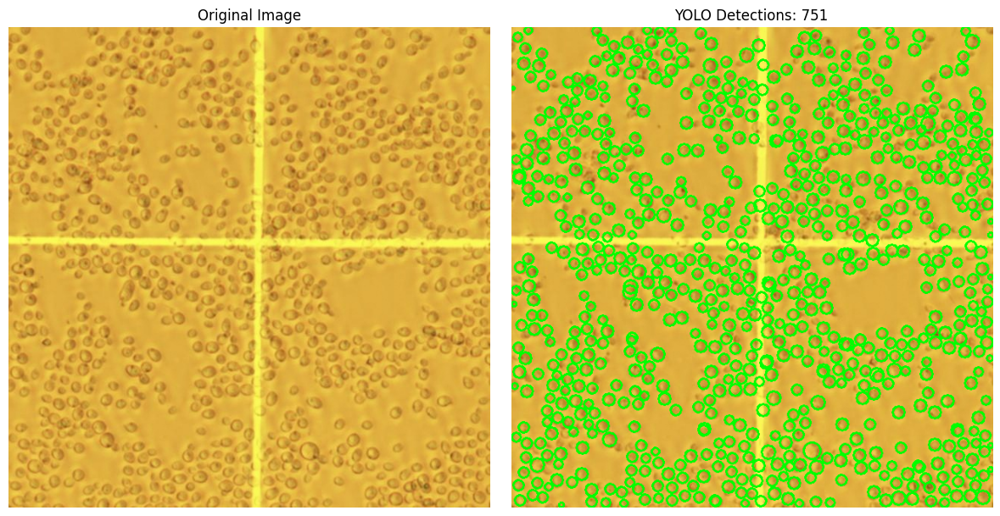

Ảnh 67/105: GT=838, UNet=421, YOLO=712
   ---> Showing visual results for images 67...


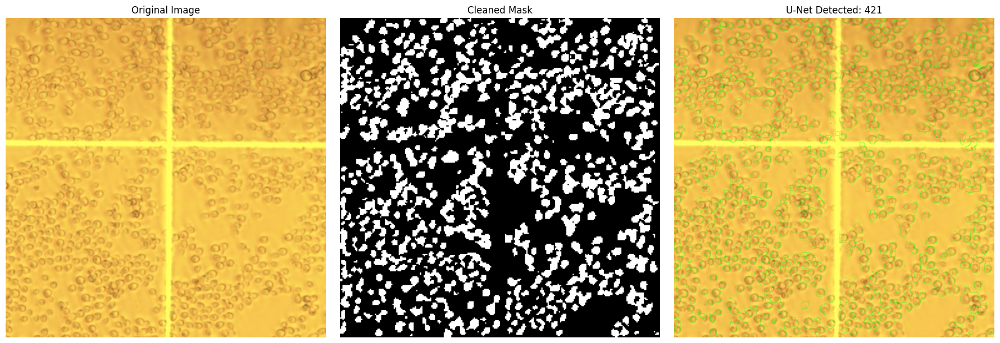

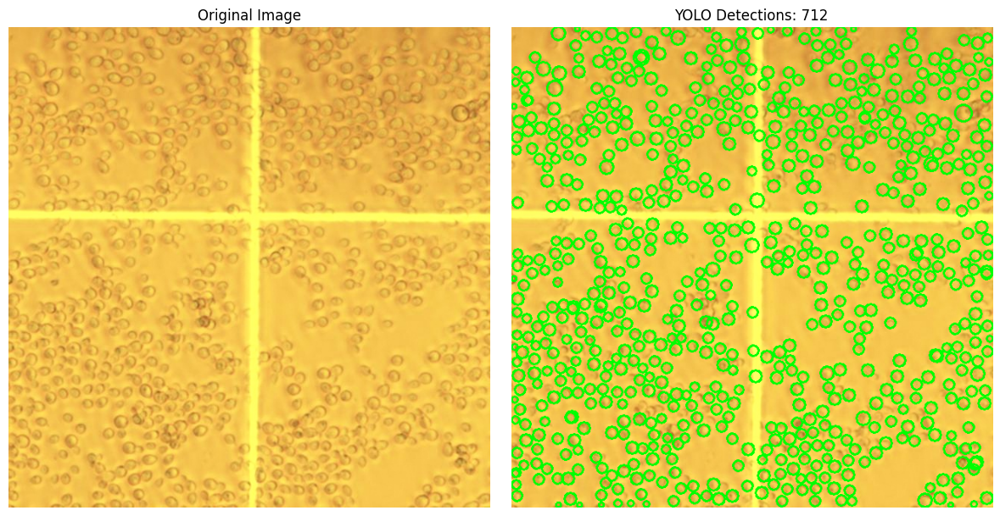

Ảnh 68/105: GT=838, UNet=308, YOLO=716
   ---> Showing visual results for images 68...


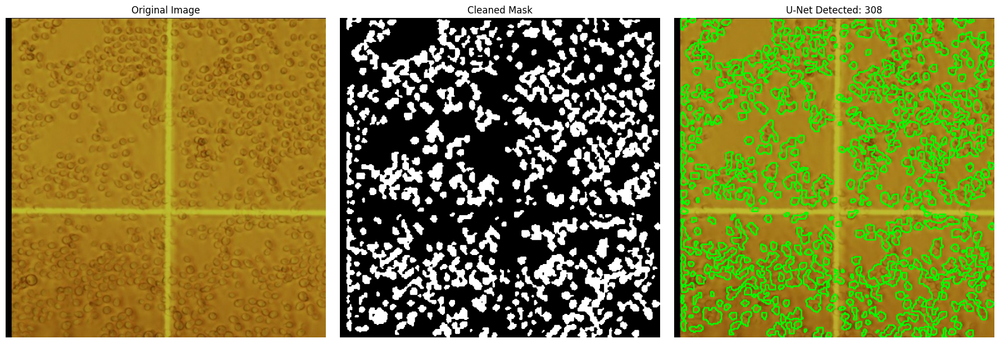

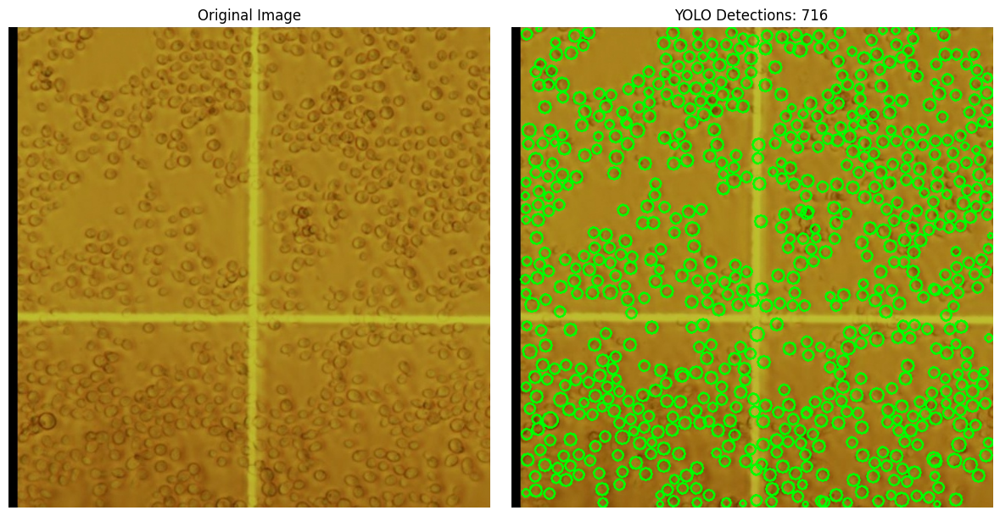

Ảnh 69/105: GT=838, UNet=334, YOLO=682
   ---> Showing visual results for images 69...


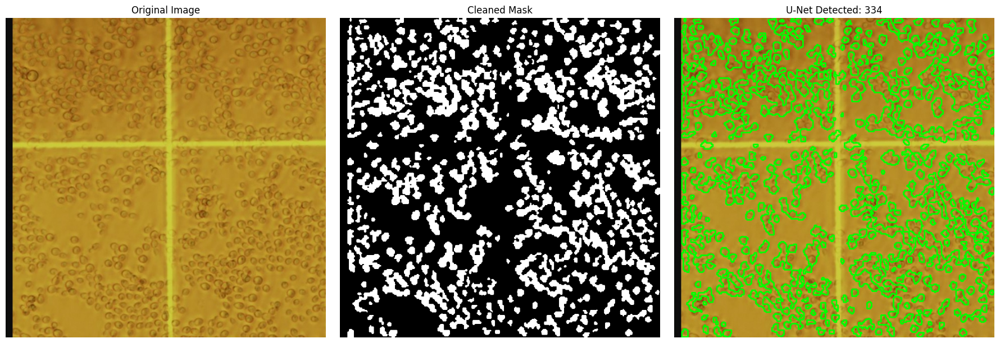

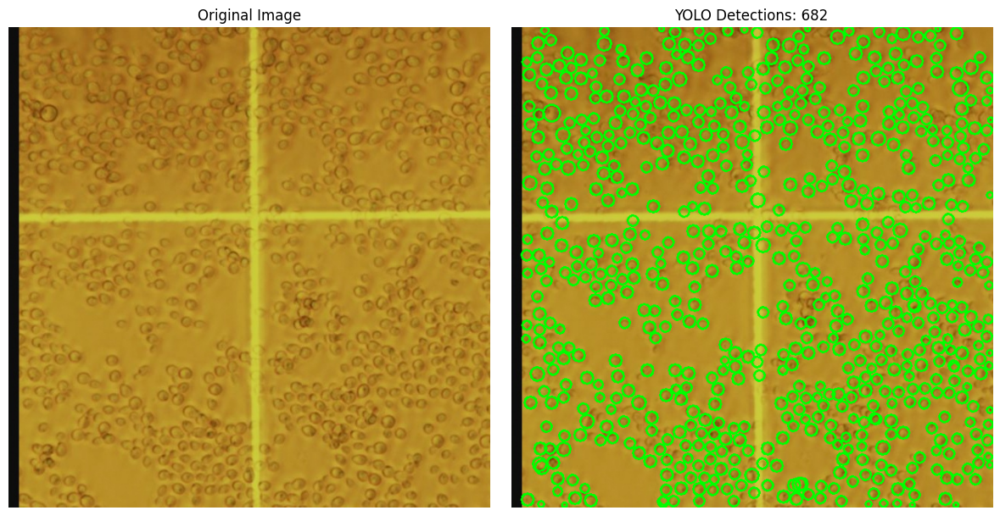

Ảnh 70/105: GT=422, UNet=264, YOLO=363
Ảnh 71/105: GT=422, UNet=261, YOLO=369
Ảnh 72/105: GT=422, UNet=259, YOLO=376
Ảnh 73/105: GT=401, UNet=212, YOLO=276
Ảnh 74/105: GT=401, UNet=265, YOLO=346
Ảnh 75/105: GT=401, UNet=230, YOLO=342
Ảnh 76/105: GT=386, UNet=207, YOLO=340
Ảnh 77/105: GT=386, UNet=218, YOLO=358
Ảnh 78/105: GT=386, UNet=199, YOLO=358
Ảnh 79/105: GT=319, UNet=216, YOLO=266
Ảnh 80/105: GT=319, UNet=211, YOLO=269
Ảnh 81/105: GT=319, UNet=200, YOLO=265
Ảnh 82/105: GT=261, UNet=88, YOLO=179
Ảnh 83/105: GT=261, UNet=93, YOLO=184
Ảnh 84/105: GT=261, UNet=100, YOLO=180
Ảnh 85/105: GT=300, UNet=196, YOLO=218
Ảnh 86/105: GT=300, UNet=195, YOLO=238
Ảnh 87/105: GT=300, UNet=205, YOLO=242
Ảnh 88/105: GT=300, UNet=217, YOLO=250
Ảnh 89/105: GT=300, UNet=192, YOLO=239
Ảnh 90/105: GT=300, UNet=221, YOLO=253
Ảnh 91/105: GT=300, UNet=121, YOLO=277
Ảnh 92/105: GT=300, UNet=140, YOLO=274
Ảnh 93/105: GT=300, UNet=139, YOLO=277
Ảnh 94/105: GT=99, UNet=91, YOLO=106
Ảnh 95/105: GT=99, UNet=82, Y

In [8]:
# --- Load Ground Truth ---
excel_path = "/kaggle/input/true-value-cell-counting/aug-true-value.xlsx"
df_gt = pd.read_excel(excel_path)
true_counts = df_gt["True values"].tolist()
img_dir = "/kaggle/input/cell-counting-roboflow-segmentation-masks/aug_inference_only/images"
img_paths = [os.path.join(img_dir, f) for f in sorted_list]
assert len(img_paths) == len(true_counts), f"Số lượng ảnh ({len(img_paths)}) và GT ({len(true_counts)}) không khớp!"

# --- Main loop ---
y_true, y_pred_unet, y_pred_yolo = [], [], []

UNET_MIN_CELL_AREA = 20
YOLO_CONF_THRESHOLD = 0.45
UNET_CONF_THRESHOLD = 0.60
indices_to_visualize = [i for i in range(57,69)]

print(f"Bắt đầu đánh giá trên {len(img_paths)} ảnh...")
print(f"Tham số U-Net: min_area = {UNET_MIN_CELL_AREA}, conf_threshold = {UNET_CONF_THRESHOLD}")
print(f"Tham số YOLO: conf_threshold = {YOLO_CONF_THRESHOLD}")
print(f"Các ảnh sẽ được hiển thị kết quả: {indices_to_visualize}")
print("-" * 60)

for i, img_path in enumerate(img_paths):
    gt = true_counts[i]
    
    # --- U-Net pipeline ---
    pred_unet, final_mask, unet_img = unet_counting_pipeline(
        model_unet, device, img_path, test_transform, min_area=UNET_MIN_CELL_AREA, unet_threshold=UNET_CONF_THRESHOLD
    )
    
    # --- YOLO pipeline ---
    pred_yolo, yolo_img, yolo_results = count_cells_yolo(
        model_yolo, img_path, conf_threshold=YOLO_CONF_THRESHOLD
    )

    y_true.append(gt)
    y_pred_unet.append(pred_unet)
    y_pred_yolo.append(pred_yolo)
    
    # Print results for each image
    print(f"Ảnh {i+1}/{len(img_paths)}: GT={gt}, UNet={pred_unet}, YOLO={pred_yolo}")
    if i in indices_to_visualize:
        print(f"   ---> Showing visual results for images {i+1}...")
        if unet_img is not None:
            visualize_unet_prediction(unet_img, final_mask, pred_unet)
        if yolo_img is not None:
            visualize_yolo_prediction(yolo_img, yolo_results, pred_yolo)

# ======================================================
# SAVE UPDATED RESULTS TO EXCEL FILE
# ======================================================

In [9]:
print("\n" + "-" * 60)
print("Evaluation loop completed.")
print("Starting updating and saving Excel file...")

# 1. Add new prediction columns to the original DataFrame
#    The lists y_pred_unet and y_pred_yolo are ordered to correspond to the rows in df_gt
df_gt['Count by Unet'] = y_pred_unet
df_gt['Count by Yolo'] = y_pred_yolo

# 2. Specify the output file path
#    In the Kaggle environment, you should save the file in the directory /kaggle/working/ 
output_excel_path = "/kaggle/working/aug-results-with-predictions.xlsx"

# 3. Save the updated DataFrame to a new Excel file
#    Use index=False to not write the pandas index column (0, 1, 2...) to the file
df_gt.to_excel(output_excel_path, index=False)

print(f"✅ Results saved successfully to file: {output_excel_path}")
print("File Excel mới chứa các cột: 'Image Name', 'True values', 'Count by Unet', 'Count by Yolo'")

# (Optional) Display the first few rows of the updated DataFrame for inspection
print("\nPreview the first 5 lines of saved data:")
print(df_gt.head())


------------------------------------------------------------
Evaluation loop completed.
Starting updating and saving Excel file...
✅ Results saved successfully to file: /kaggle/working/aug-results-with-predictions.xlsx
File Excel mới chứa các cột: 'Image Name', 'True values', 'Count by Unet', 'Count by Yolo'

Preview the first 5 lines of saved data:
   Id  True values  Count by Unet  Count by Yolo
0   1           89             44             89
1   2           89             51             93
2   3           89             49             94
3   4           60             53             62
4   5           60             59             55


In [12]:
metrics_data = []
models = {"U-Net": y_pred_unet, "YOLO": y_pred_yolo}

for model_name, y_pred in models.items():
    mse = mean_squared_error(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    metrics_data.append({
        "Model": model_name, "MAE": f"{mae:.2f}",
        "MAPE": f"{mape:.2f}", "R2_Score": f"{r2:.2f}",
        "RMSE": f"{sqrt(mse):.2f}"
    })

df_metrics = pd.DataFrame(metrics_data)
print("\n" + "="*50)
print("--- FINAL EVALUATION RESULTS TABLE ---")
print("="*50)
print(df_metrics.to_string(index=False))


--- FINAL EVALUATION RESULTS TABLE ---
Model    MAE MAPE R2_Score   RMSE
U-Net 109.13 0.32     0.47 183.25
 YOLO  43.15 0.14     0.92  71.34


# ===================================================================
# ERROR ANALYSIS AND MORE VISUALIZATION
# ===================================================================


--- DISPERSION STATISTICS ---
U-Net: Std of Absolute Errors = 147.20
YOLO: Std of Absolute Errors = 56.81


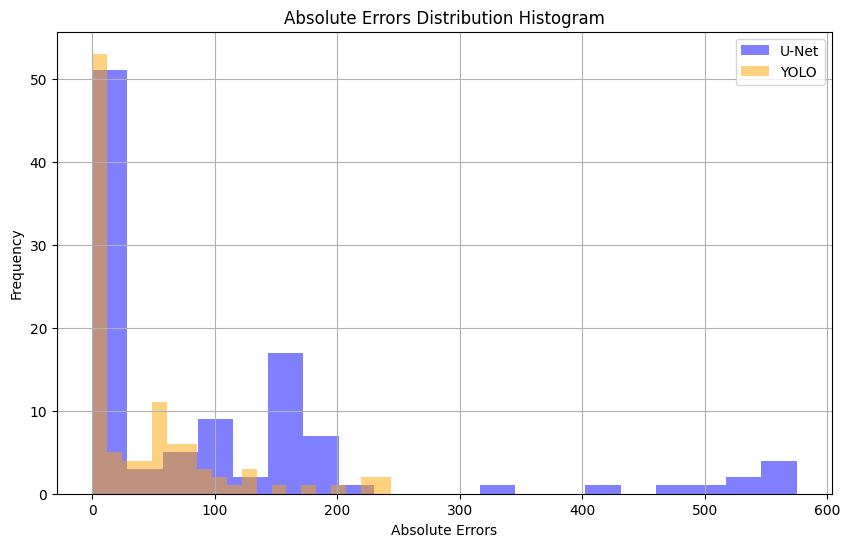

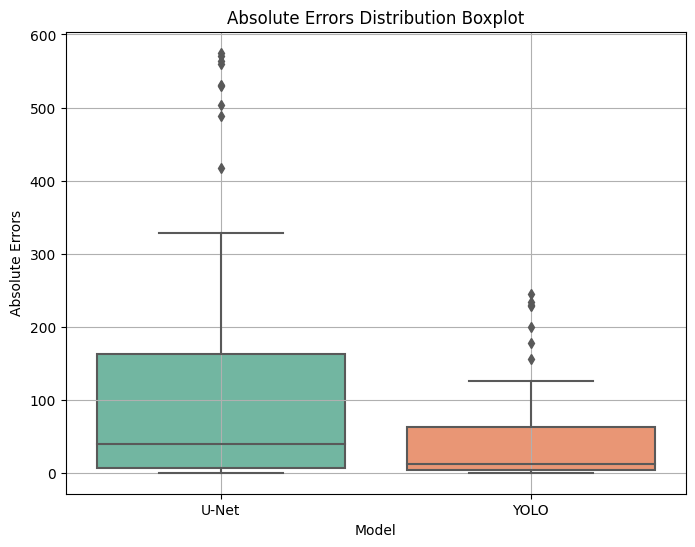

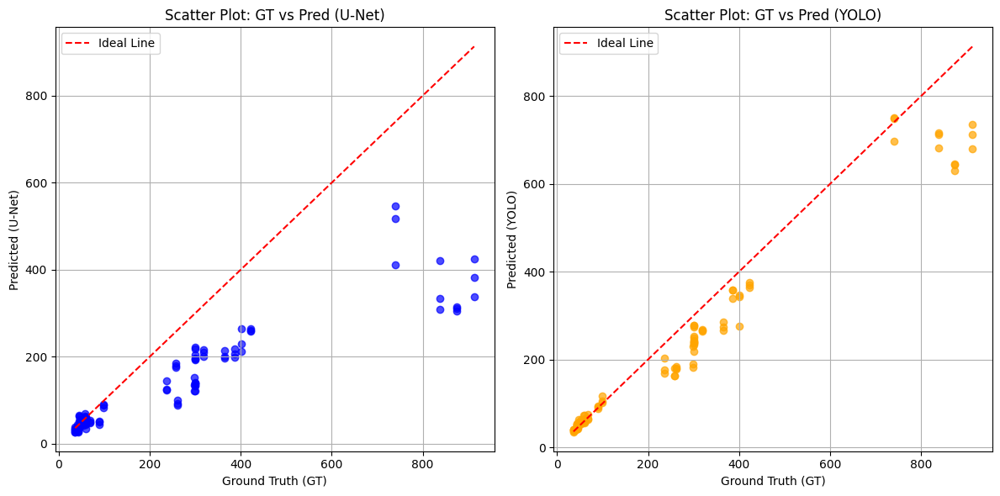

In [11]:
# Convert lists to numpy arrays for easy computation
y_true_np = np.array(y_true)
y_pred_unet_np = np.array(y_pred_unet)
y_pred_yolo_np = np.array(y_pred_yolo)

# Calculate absolute errors for each sample
abs_errors_unet = np.abs(y_true_np - y_pred_unet_np)
abs_errors_yolo = np.abs(y_true_np - y_pred_yolo_np)

# Calculate dispersion statistics: Standard deviation of absolute errors (std of MAE per sample)
std_unet = np.std(abs_errors_unet)
std_yolo = np.std(abs_errors_yolo)

# Print dispersion statistics
print("\n" + "="*50)
print("--- DISPERSION STATISTICS ---")
print("="*50)
print(f"U-Net: Std of Absolute Errors = {std_unet:.2f}")
print(f"YOLO: Std of Absolute Errors = {std_yolo:.2f}")

# 1. Absolute Errors Distribution Histogram
plt.figure(figsize=(10, 6))
plt.hist(abs_errors_unet, bins=20, alpha=0.5, label='U-Net', color='blue')
plt.hist(abs_errors_yolo, bins=20, alpha=0.5, label='YOLO', color='orange')
plt.title('Absolute Errors Distribution Histogram')
plt.xlabel('Absolute Errors')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()

# 2. Absolute Errors Distribution Boxplot
data_errors = pd.DataFrame({
    'Model': ['U-Net'] * len(abs_errors_unet) + ['YOLO'] * len(abs_errors_yolo),
    'Absolute Error': np.concatenate([abs_errors_unet, abs_errors_yolo])
})

plt.figure(figsize=(8, 6))
sns.boxplot(x='Model', y='Absolute Error', data=data_errors, palette='Set2')
plt.title('Absolute Errors Distribution Boxplot')
plt.ylabel('Absolute Errors')
plt.grid(True)
plt.show()

# 3. Scatter plot GT vs Pred for each model
plt.figure(figsize=(12, 6))

# Scatter for U-Net
plt.subplot(1, 2, 1)
plt.scatter(y_true, y_pred_unet, alpha=0.7, color='blue')
plt.plot([min(y_true), max(y_true)], [min(y_true), max(y_true)], 'r--', label='Ideal Line')
plt.title('Scatter Plot: GT vs Pred (U-Net)')
plt.xlabel('Ground Truth (GT)')
plt.ylabel('Predicted (U-Net)')
plt.legend()
plt.grid(True)

# Scatter for YOLO
plt.subplot(1, 2, 2)
plt.scatter(y_true, y_pred_yolo, alpha=0.7, color='orange')
plt.plot([min(y_true), max(y_true)], [min(y_true), max(y_true)], 'r--', label='Ideal Line')
plt.title('Scatter Plot: GT vs Pred (YOLO)')
plt.xlabel('Ground Truth (GT)')
plt.ylabel('Predicted (YOLO)')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()